In [2]:
import cv2
import os
import random
import numpy as np
from matplotlib import pyplot as plt

In [3]:
import os

# Function to rename files in ascending order
def rename_files(root_dir):
    # Initialize a counter for file renaming
    counter = 1

    # Recursively traverse through directories
    for root, dirs, files in os.walk(root_dir):
        for file_name in files:
            # Construct the old and new file paths
            old_path = os.path.join(root, file_name)
            new_path = os.path.join(root, f"{counter}.jpg")

            # Rename the file
            os.rename(old_path, new_path)

            # Increment the counter
            counter += 1

# Specify the root directory
root_directory = "/content/input_images"

# Call the function to rename files
rename_files(root_directory)


In [4]:
import numpy as np
import imgaug.augmenters as iaa
import cv2
import os

# Define the directory containing your original images
input_dir = "/content/input_images"
# Define the directory where augmented images will be saved
output_dir = "/content/data"

# Ensure the output directory exists
os.makedirs(output_dir, exist_ok=True)


# Loop through original images
i=30
while(i < 1001):
  # Generate a random integer between x and y (inclusive)
  x = -100  # lower bound
  y = 101  # upper bound
  random_int1 = random.randint(x, y)
  random_int2 = random.randint(x, y)
  x2 = 0.1
  y2 = 1.0
  random_int3 = random.uniform(x2, y2)
  random_int4 = random.uniform(x2, y2)

  # Define augmentation pipeline
  aug_pipeline = iaa.Sequential([
    # iaa.Fliplr(0.5),  # horizontally flip 50% of images
    iaa.Affine(rotate=(random_int1, random_int2)),  # rotate images by -10 to +10 degrees
    iaa.GaussianBlur(sigma=(random_int3, random_int4)),  # apply gaussian blur with sigma between 0 and 1.0
    iaa.AdditiveGaussianNoise(scale=(0, 0.05*255))  # add gaussian noise
    ])
  for filename in os.listdir(input_dir):
    if filename.endswith(".jpg") or filename.endswith(".png"):  # assuming images are jpg or png
      # Read image
      img = cv2.imread(os.path.join(input_dir, filename))

      # Apply augmentation
      augmented_img = aug_pipeline(image=img)

      # Save augmented image
      output_path = os.path.join(output_dir, f"{i}.jpg")
      cv2.imwrite(output_path, augmented_img)

      print(f"Augmented image saved: {output_path}")
      i+=1

Augmented image saved: /content/data/30.jpg
Augmented image saved: /content/data/31.jpg
Augmented image saved: /content/data/32.jpg
Augmented image saved: /content/data/33.jpg
Augmented image saved: /content/data/34.jpg
Augmented image saved: /content/data/35.jpg
Augmented image saved: /content/data/36.jpg
Augmented image saved: /content/data/37.jpg
Augmented image saved: /content/data/38.jpg
Augmented image saved: /content/data/39.jpg
Augmented image saved: /content/data/40.jpg
Augmented image saved: /content/data/41.jpg
Augmented image saved: /content/data/42.jpg
Augmented image saved: /content/data/43.jpg
Augmented image saved: /content/data/44.jpg
Augmented image saved: /content/data/45.jpg
Augmented image saved: /content/data/46.jpg
Augmented image saved: /content/data/47.jpg
Augmented image saved: /content/data/48.jpg
Augmented image saved: /content/data/49.jpg
Augmented image saved: /content/data/50.jpg
Augmented image saved: /content/data/51.jpg
Augmented image saved: /content/

In [5]:
import os
import shutil

# Define the parent folder and the folder containing files to be copied
parent_folder = "/content/data"
folder_to_copy = "/content/input_images"

# Get the list of files in the folder to be copied
files_to_copy = os.listdir(folder_to_copy)

# Loop through the files and copy them to the parent folder
for file_name in files_to_copy:
    source_path = os.path.join(folder_to_copy, file_name)
    destination_path = os.path.join(parent_folder, file_name)
    shutil.copyfile(source_path, destination_path)
    print(f"Copied {file_name} to {destination_path}")

Copied 4.jpg to /content/data/4.jpg
Copied 6.jpg to /content/data/6.jpg
Copied 12.jpg to /content/data/12.jpg
Copied 14.jpg to /content/data/14.jpg
Copied 28.jpg to /content/data/28.jpg
Copied 15.jpg to /content/data/15.jpg
Copied 19.jpg to /content/data/19.jpg
Copied 24.jpg to /content/data/24.jpg
Copied 9.jpg to /content/data/9.jpg
Copied 8.jpg to /content/data/8.jpg
Copied 23.jpg to /content/data/23.jpg
Copied 27.jpg to /content/data/27.jpg
Copied 11.jpg to /content/data/11.jpg
Copied 7.jpg to /content/data/7.jpg
Copied 22.jpg to /content/data/22.jpg
Copied 25.jpg to /content/data/25.jpg
Copied 18.jpg to /content/data/18.jpg
Copied 20.jpg to /content/data/20.jpg
Copied 21.jpg to /content/data/21.jpg
Copied 1.jpg to /content/data/1.jpg
Copied 13.jpg to /content/data/13.jpg
Copied 2.jpg to /content/data/2.jpg
Copied 10.jpg to /content/data/10.jpg
Copied 26.jpg to /content/data/26.jpg
Copied 16.jpg to /content/data/16.jpg
Copied 5.jpg to /content/data/5.jpg
Copied 3.jpg to /content/dat

In [6]:
import cv2
import os

# Load the pre-trained face detection model
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

# Define input and output directories
input_dir = "/content/input_images"
output_dir = "/content/data_with_faces"

# Create the output directory if it does not exist
os.makedirs(output_dir, exist_ok=True)

# Loop through images in the input directory
for filename in os.listdir(input_dir):
    if filename.endswith(".jpg") or filename.endswith(".png"):
        # Read image
        img_path = os.path.join(input_dir, filename)
        img = cv2.imread(img_path)

        # Convert image to grayscale
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

        # Detect faces in the image
        faces = face_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=5, minSize=(30, 30))

        # Print information about the image and detected faces
        print(f"Image: {filename}")
        print(f"Detected {len(faces)} face(s)")

        # Draw bounding boxes around the detected faces
        for i, (x, y, w, h) in enumerate(faces, 1):
            cv2.rectangle(img, (x, y), (x+w, y+h), (255, 0, 0), 2)
            print(f"Face {i}: (x={x}, y={y}), width={w}, height={h}")

        # Save image with detected faces
        output_path = os.path.join(output_dir, filename)
        cv2.imwrite(output_path, img)

        print(f"Processed image saved: {output_path}\n")


Image: 4.jpg
Detected 3 face(s)
Face 1: (x=13, y=277), width=84, height=84
Face 2: (x=381, y=357), width=106, height=106
Face 3: (x=229, y=938), width=140, height=140
Processed image saved: /content/data_with_faces/4.jpg

Image: 6.jpg
Detected 0 face(s)
Processed image saved: /content/data_with_faces/6.jpg

Image: 12.jpg
Detected 1 face(s)
Face 1: (x=120, y=231), width=226, height=226
Processed image saved: /content/data_with_faces/12.jpg

Image: 14.jpg
Detected 0 face(s)
Processed image saved: /content/data_with_faces/14.jpg

Image: 28.jpg
Detected 0 face(s)
Processed image saved: /content/data_with_faces/28.jpg

Image: 15.jpg
Detected 0 face(s)
Processed image saved: /content/data_with_faces/15.jpg

Image: 19.jpg
Detected 0 face(s)
Processed image saved: /content/data_with_faces/19.jpg

Image: 24.jpg
Detected 2 face(s)
Face 1: (x=150, y=190), width=212, height=212
Face 2: (x=1193, y=323), width=79, height=79
Processed image saved: /content/data_with_faces/24.jpg

Image: 9.jpg
Detecte

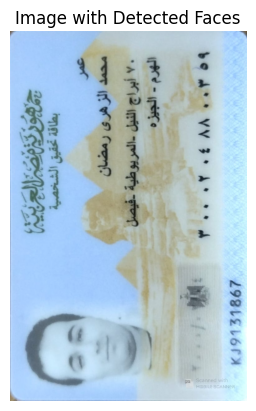

Processed image saved: /content/data_with_faces/4.jpg


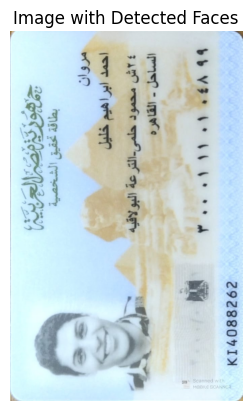

Processed image saved: /content/data_with_faces/6.jpg


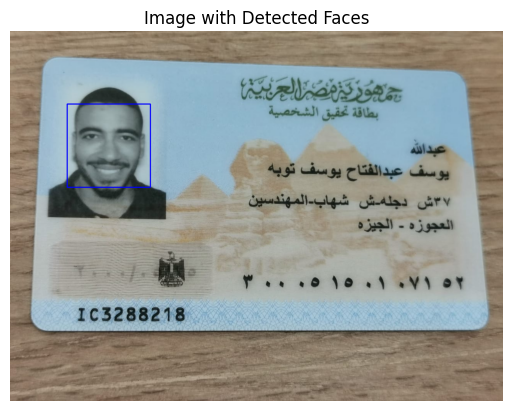

Processed image saved: /content/data_with_faces/12.jpg


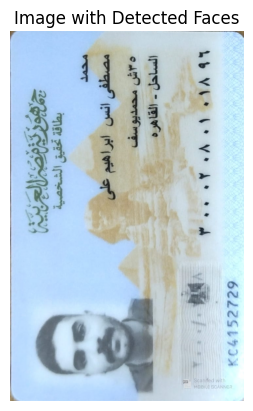

Processed image saved: /content/data_with_faces/14.jpg


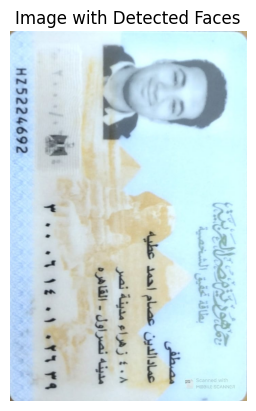

Processed image saved: /content/data_with_faces/15.jpg


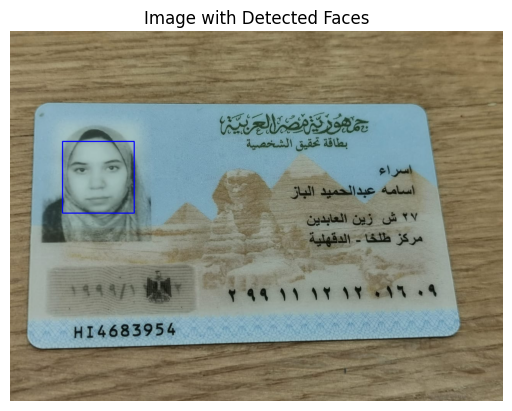

Processed image saved: /content/data_with_faces/9.jpg


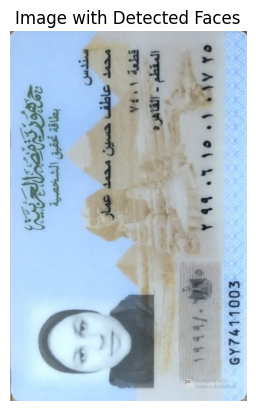

Processed image saved: /content/data_with_faces/8.jpg


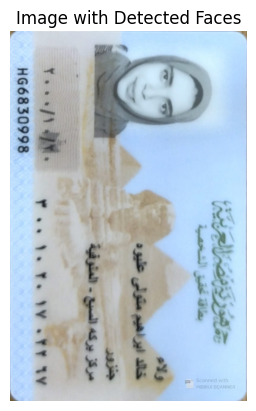

Processed image saved: /content/data_with_faces/11.jpg


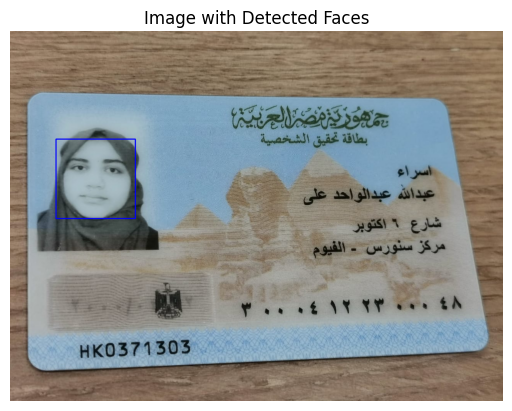

Processed image saved: /content/data_with_faces/18.jpg


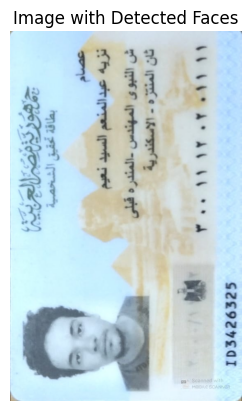

Processed image saved: /content/data_with_faces/13.jpg


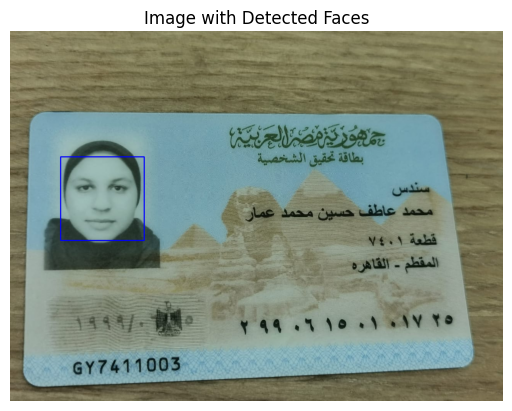

Processed image saved: /content/data_with_faces/16.jpg


In [ ]:
import cv2
import os
import matplotlib.pyplot as plt

# Load the pre-trained face detection model
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

# Define input and output directories
input_dir = "/content/input_images"
output_dir = "/content/data_with_faces"

# Create the output directory if it does not exist
os.makedirs(output_dir, exist_ok=True)

# Loop through images in the input directory
for filename in os.listdir(input_dir):
    if filename.endswith(".jpg") or filename.endswith(".png"):
        # Read image
        img_path = os.path.join(input_dir, filename)
        img = cv2.imread(img_path)

        # Convert image to grayscale
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

        # Detect faces in the image
        faces = face_cascade.detectMultiScale(gray, scaleFactor=1.3, minNeighbors=5, minSize=(30, 30))

        # Draw bounding boxes around the detected faces
        for (x, y, w, h) in faces:
            cv2.rectangle(img, (x, y), (x+w, y+h), (255, 0, 0), 2)

        # Display image with detected faces
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.imshow(img_rgb)
        plt.axis('off')
        plt.title("Image with Detected Faces")
        plt.show()

        # Save image with detected faces
        output_path = os.path.join(output_dir, filename)
        cv2.imwrite(output_path, img)

        print(f"Processed image saved: {output_path}")


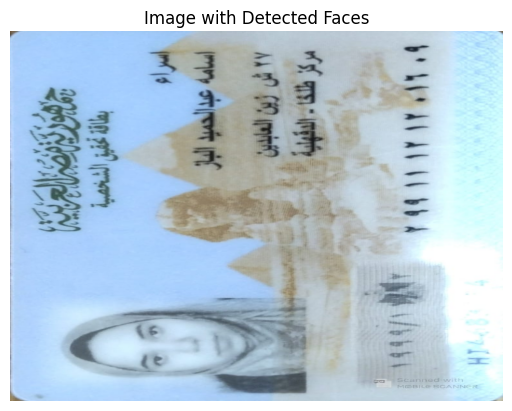

Processed image saved: /content/data_with_faces/4.jpg


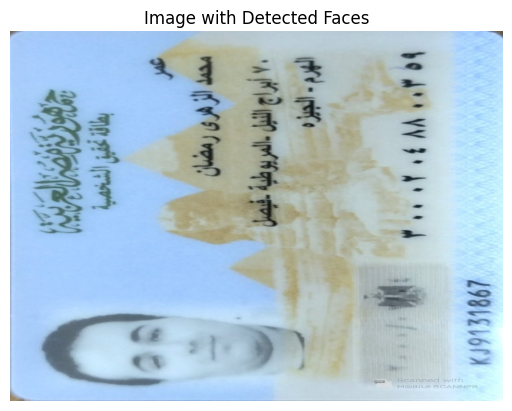

Processed image saved: /content/data_with_faces/6.jpg


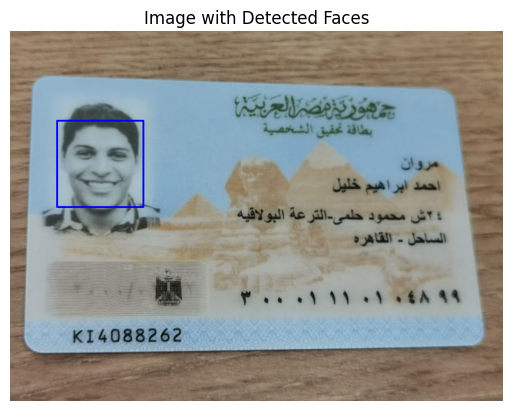

Processed image saved: /content/data_with_faces/12.jpg


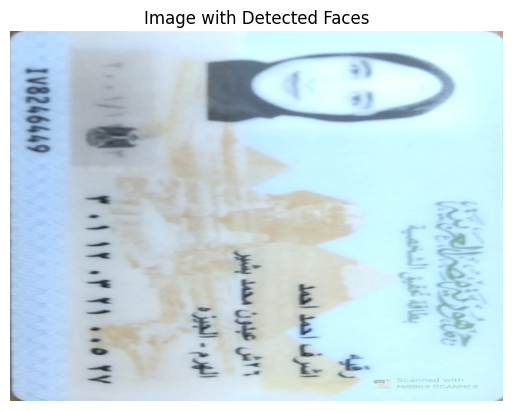

Processed image saved: /content/data_with_faces/14.jpg


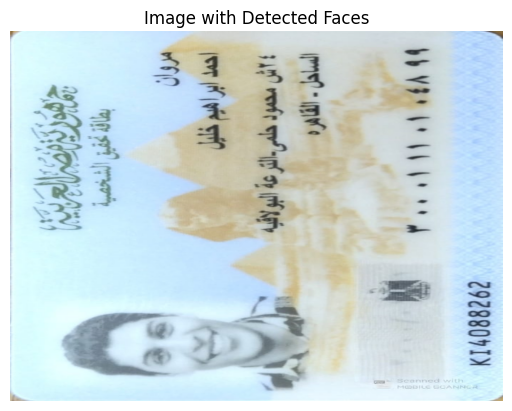

Processed image saved: /content/data_with_faces/28.jpg


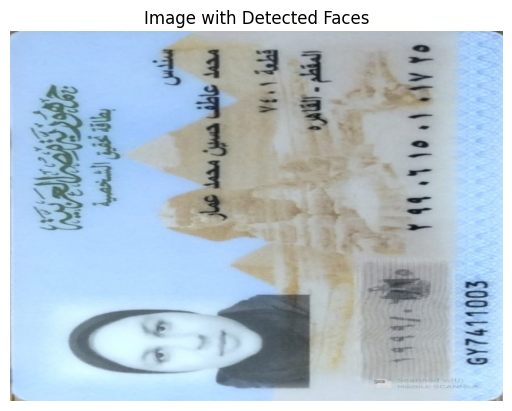

Processed image saved: /content/data_with_faces/15.jpg


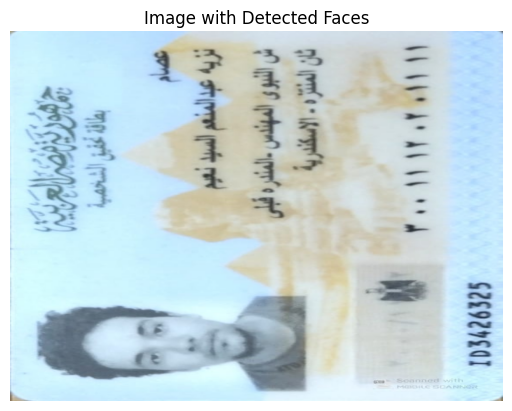

Processed image saved: /content/data_with_faces/19.jpg


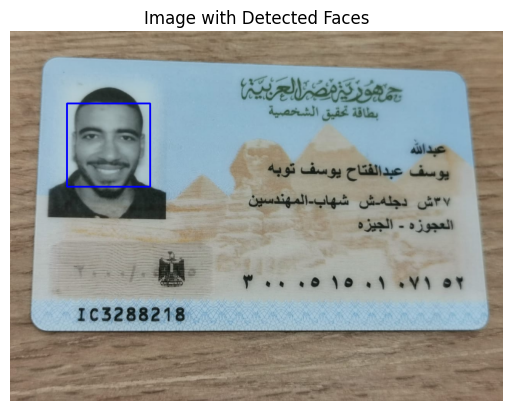

Processed image saved: /content/data_with_faces/24.jpg


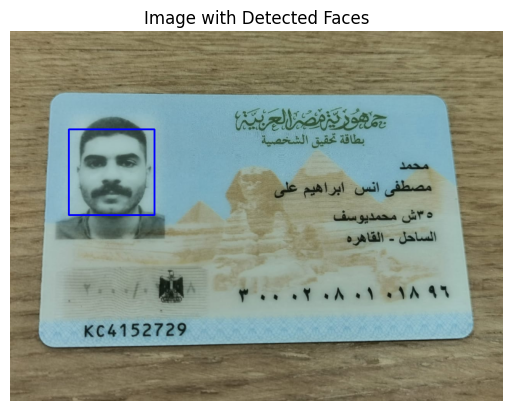

Processed image saved: /content/data_with_faces/9.jpg


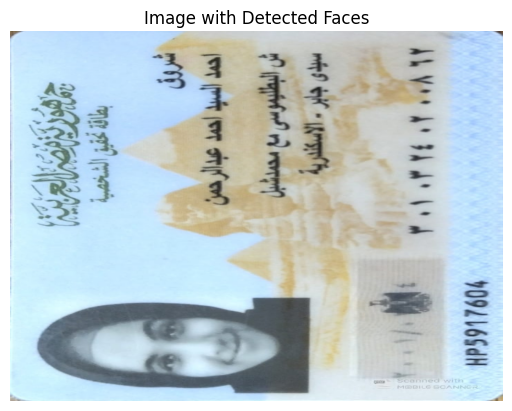

Processed image saved: /content/data_with_faces/8.jpg


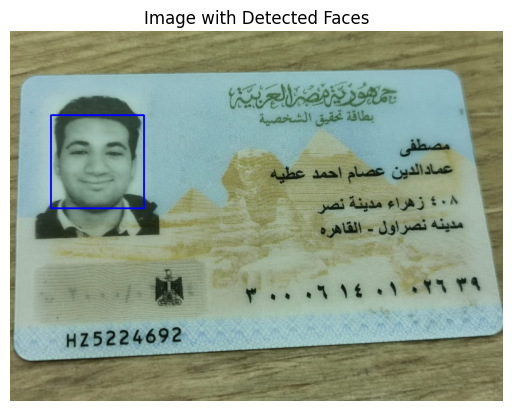

Processed image saved: /content/data_with_faces/23.jpg


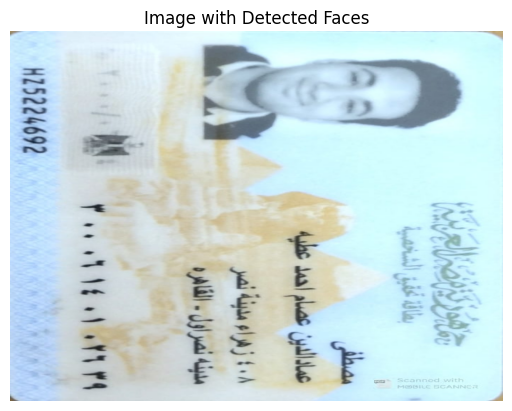

Processed image saved: /content/data_with_faces/27.jpg


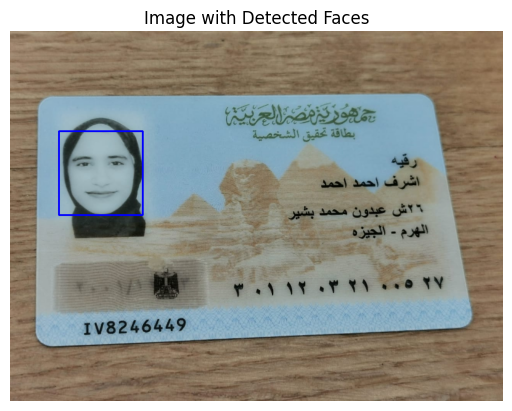

Processed image saved: /content/data_with_faces/11.jpg


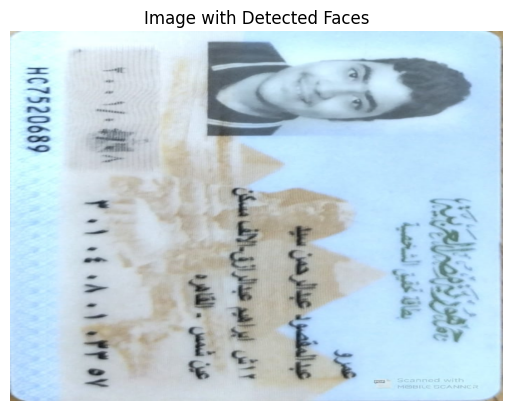

Processed image saved: /content/data_with_faces/7.jpg


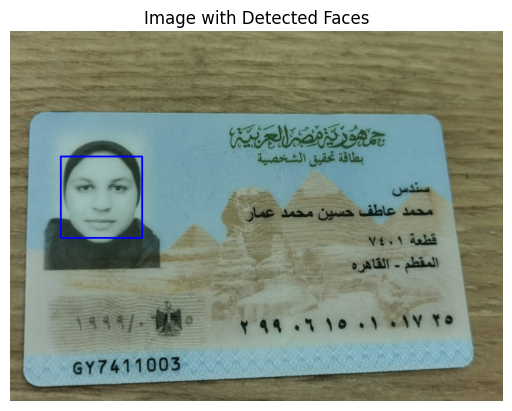

Processed image saved: /content/data_with_faces/22.jpg


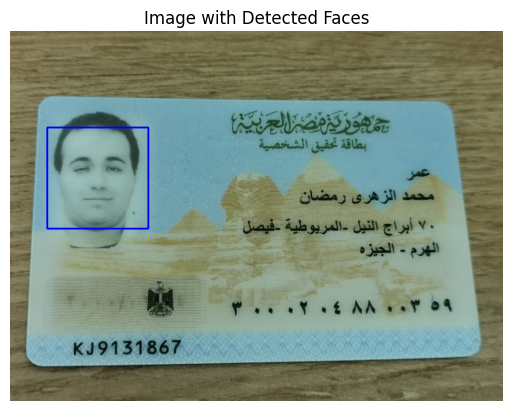

Processed image saved: /content/data_with_faces/25.jpg


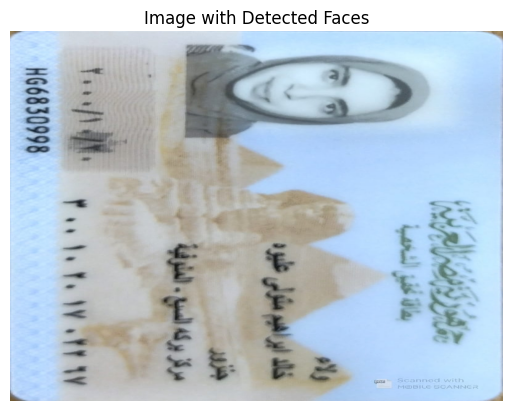

Processed image saved: /content/data_with_faces/18.jpg


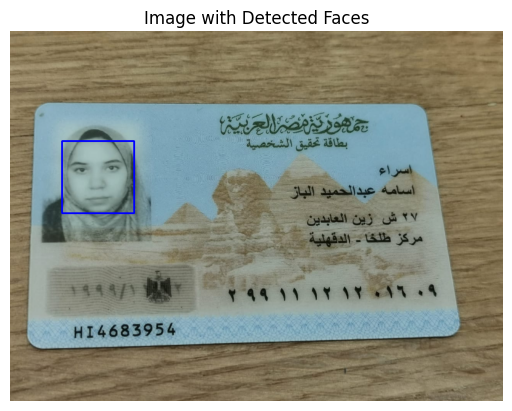

Processed image saved: /content/data_with_faces/20.jpg


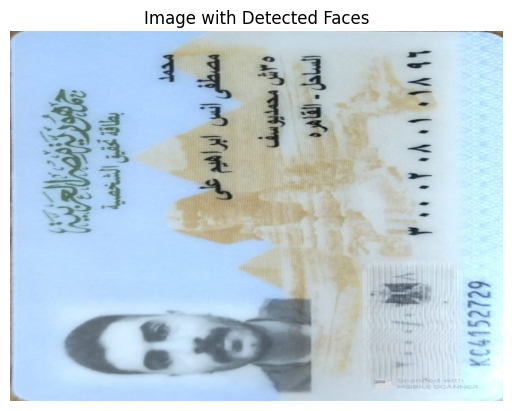

Processed image saved: /content/data_with_faces/21.jpg


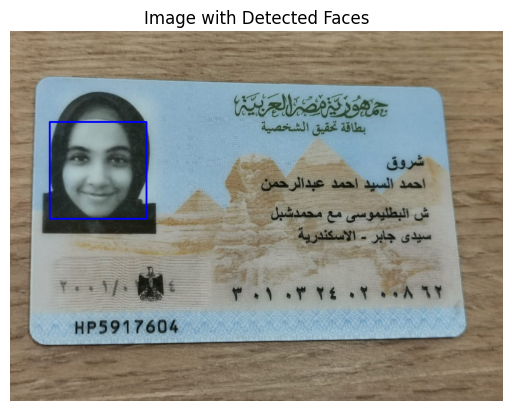

Processed image saved: /content/data_with_faces/1.jpg


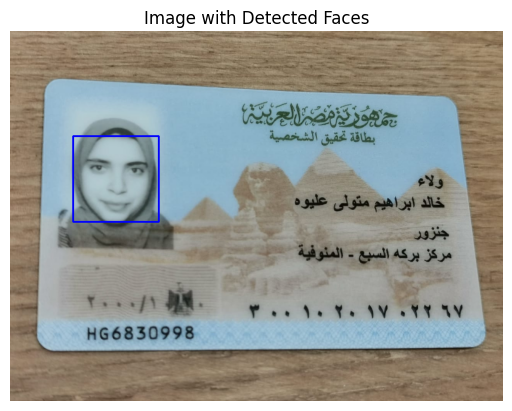

Processed image saved: /content/data_with_faces/13.jpg


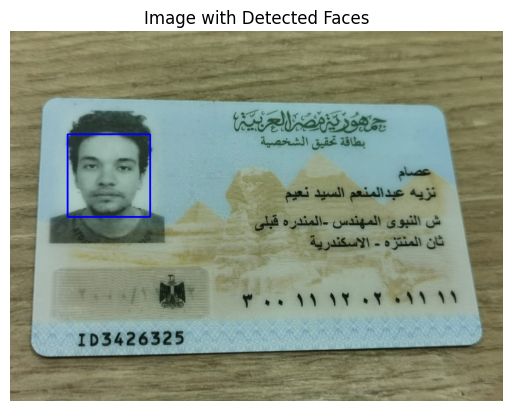

Processed image saved: /content/data_with_faces/2.jpg


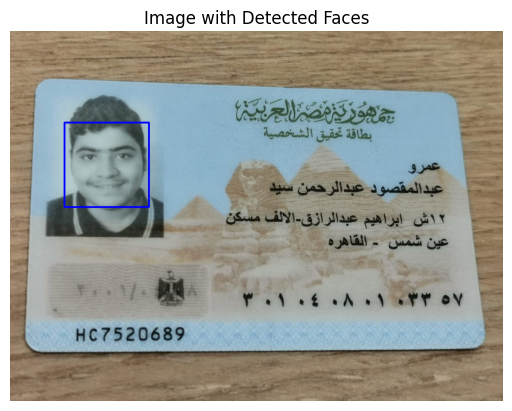

Processed image saved: /content/data_with_faces/10.jpg


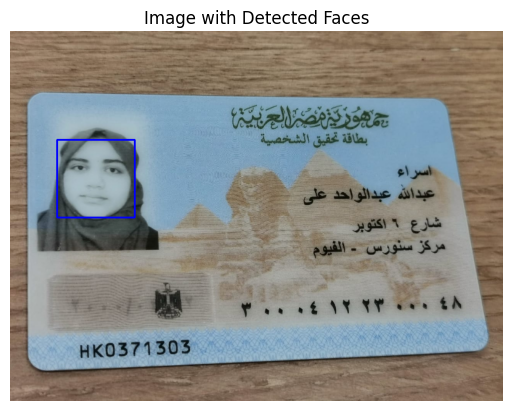

Processed image saved: /content/data_with_faces/26.jpg


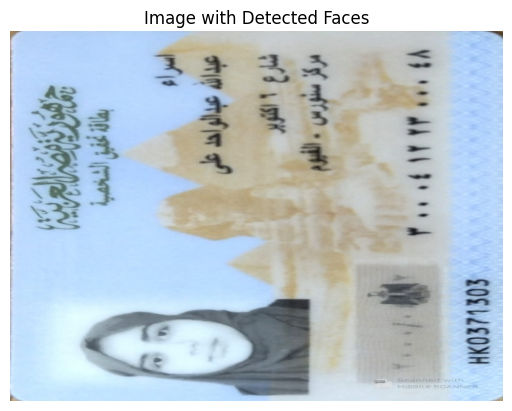

Processed image saved: /content/data_with_faces/16.jpg


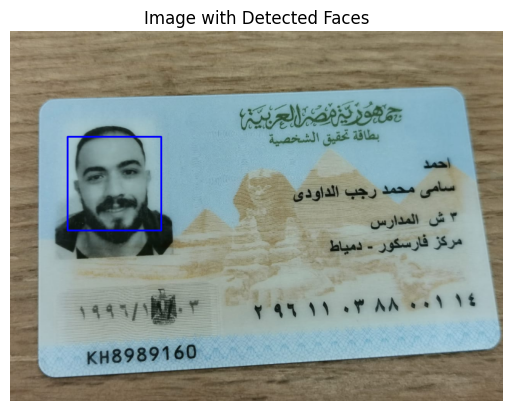

Processed image saved: /content/data_with_faces/5.jpg


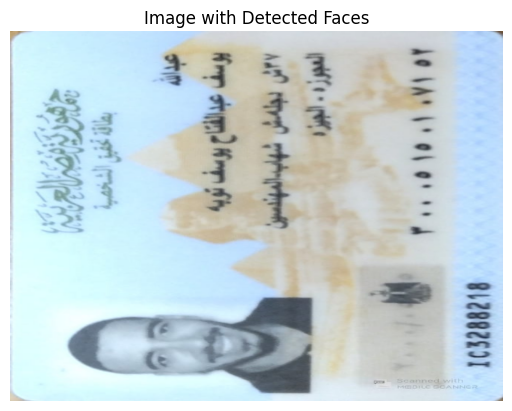

Processed image saved: /content/data_with_faces/3.jpg


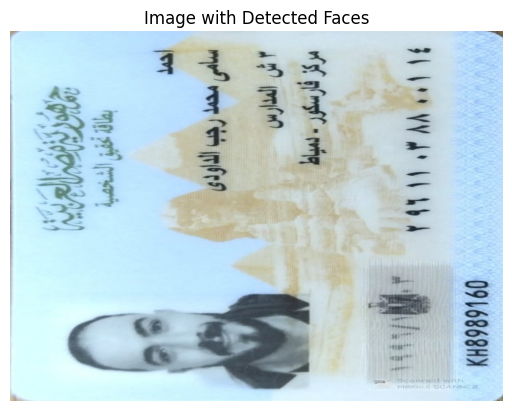

Processed image saved: /content/data_with_faces/17.jpg


In [12]:
import cv2
import os
import matplotlib.pyplot as plt

# Load the pre-trained face detection model
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

# Define input and output directories
input_dir = "/content/input_images"
output_dir = "/content/data_with_faces"

# Create the output directory if it does not exist
os.makedirs(output_dir, exist_ok=True)

# Loop through images in the input directory
for filename in os.listdir(input_dir):
    if filename.endswith(".jpg") or filename.endswith(".png"):
        # Read image
        img_path = os.path.join(input_dir, filename)
        img = cv2.imread(img_path)

        # Resize image for faster processing
        img = cv2.resize(img, (800, 600))  # You can adjust the dimensions as needed

        # Convert image to grayscale
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

        # Histogram equalization (optional, depending on image quality)
        # gray = cv2.equalizeHist(gray)

        # Normalize the image (optional, if needed)
        # gray = cv2.normalize(gray, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)

        # Detect faces in the image
        faces = face_cascade.detectMultiScale(gray, scaleFactor=1.3, minNeighbors=5, minSize=(30, 30))

        # Draw bounding boxes around the detected faces
        for (x, y, w, h) in faces:
            cv2.rectangle(img, (x, y), (x+w, y+h), (255, 0, 0), 2)

        # Display image with detected faces
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.imshow(img_rgb)
        plt.axis('off')
        plt.title("Image with Detected Faces")
        plt.show()

        # Save image with detected faces
        output_path = os.path.join(output_dir, filename)
        cv2.imwrite(output_path, img)

        print(f"Processed image saved: {output_path}")


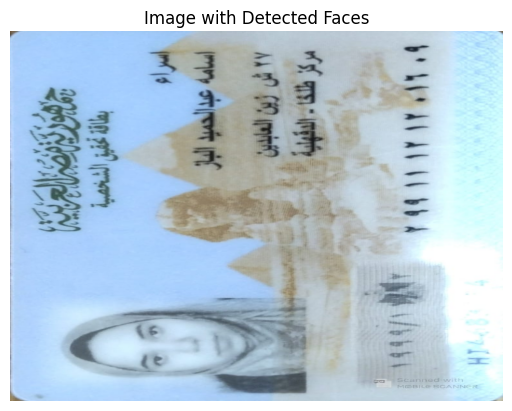

Processed image saved: /content/data_with_faces/4.jpg


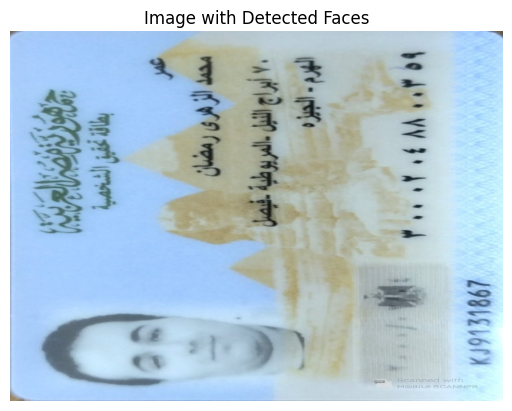

Processed image saved: /content/data_with_faces/6.jpg


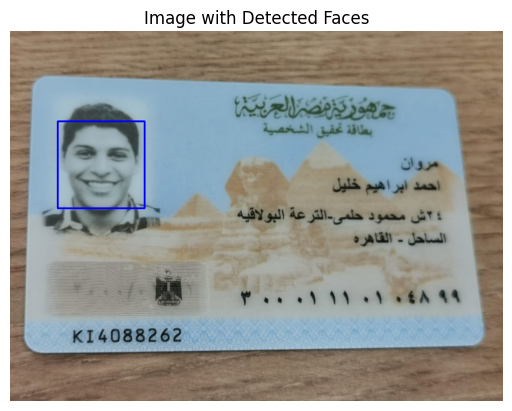

Processed image saved: /content/data_with_faces/12.jpg


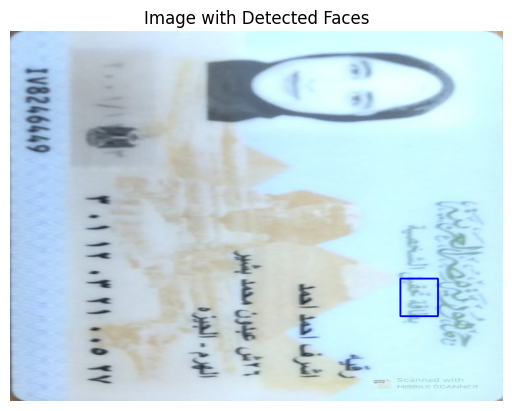

Processed image saved: /content/data_with_faces/14.jpg


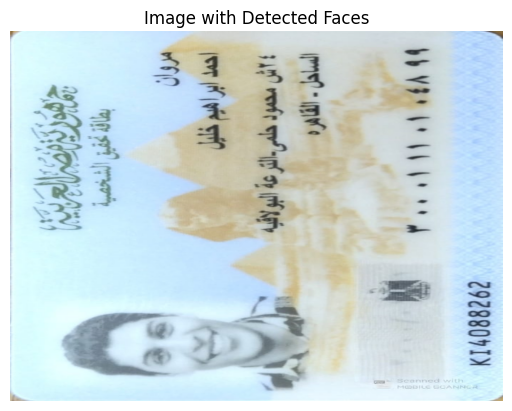

Processed image saved: /content/data_with_faces/28.jpg


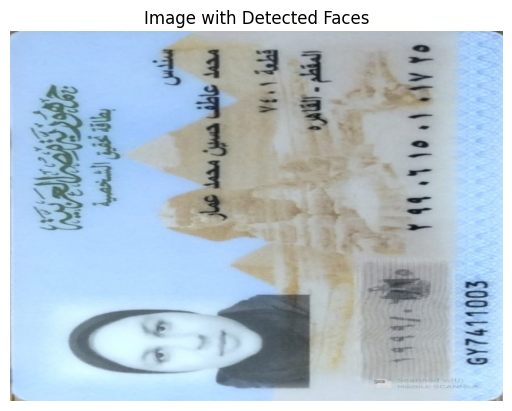

Processed image saved: /content/data_with_faces/15.jpg


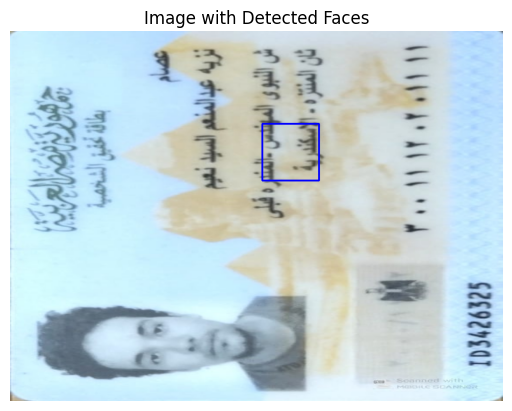

Processed image saved: /content/data_with_faces/19.jpg


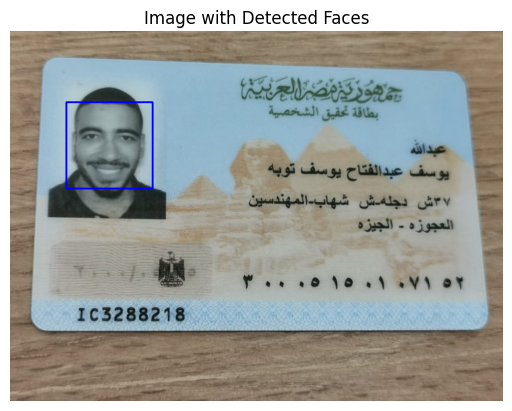

Processed image saved: /content/data_with_faces/24.jpg


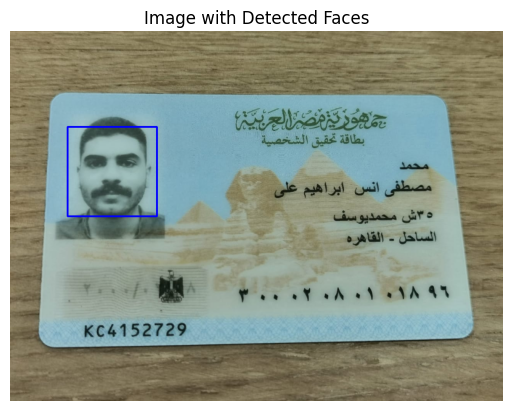

Processed image saved: /content/data_with_faces/9.jpg


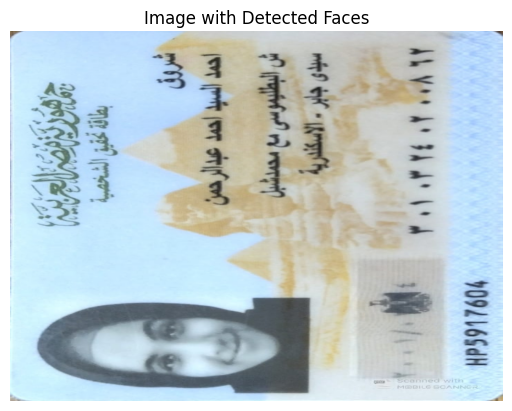

Processed image saved: /content/data_with_faces/8.jpg


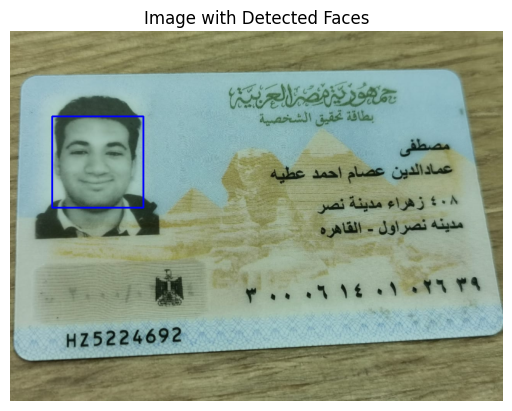

Processed image saved: /content/data_with_faces/23.jpg


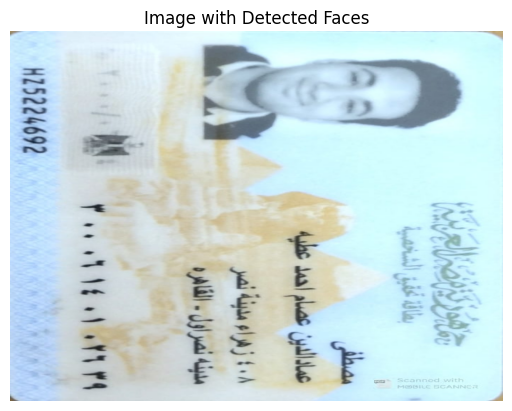

Processed image saved: /content/data_with_faces/27.jpg


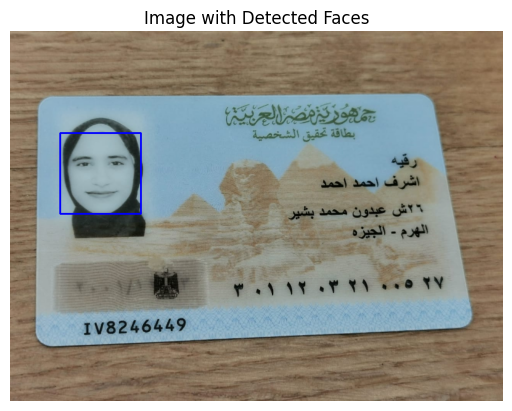

Processed image saved: /content/data_with_faces/11.jpg


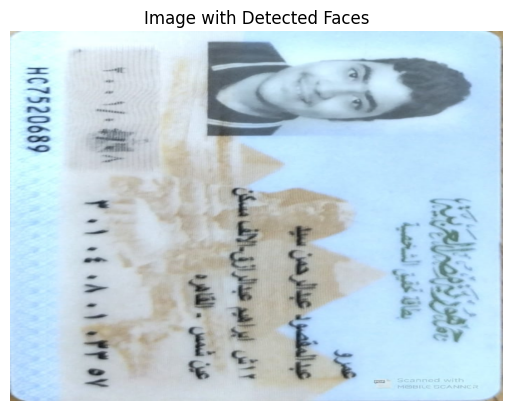

Processed image saved: /content/data_with_faces/7.jpg


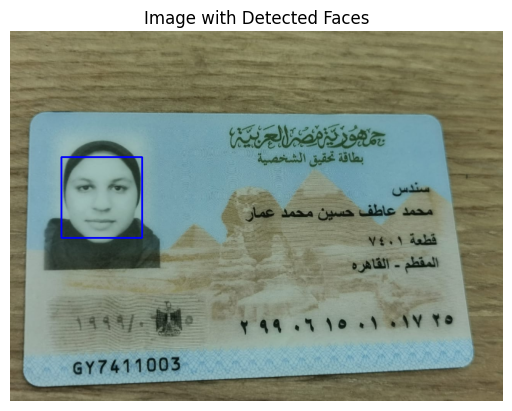

Processed image saved: /content/data_with_faces/22.jpg


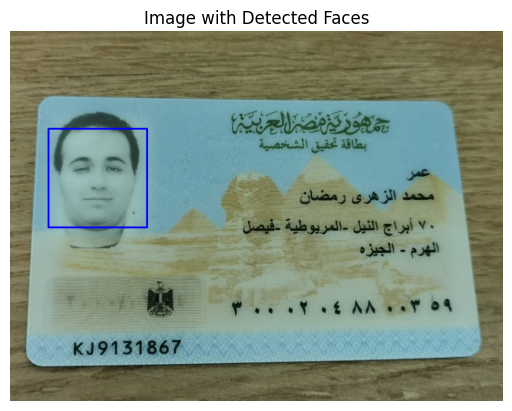

Processed image saved: /content/data_with_faces/25.jpg


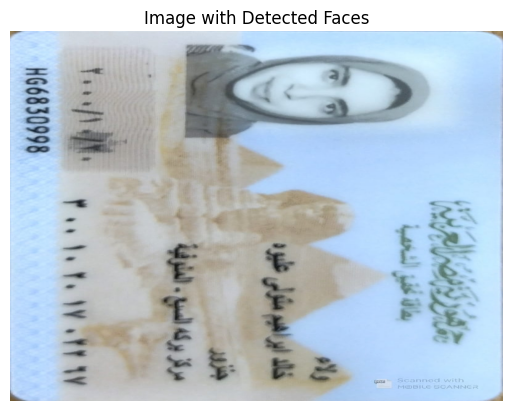

Processed image saved: /content/data_with_faces/18.jpg


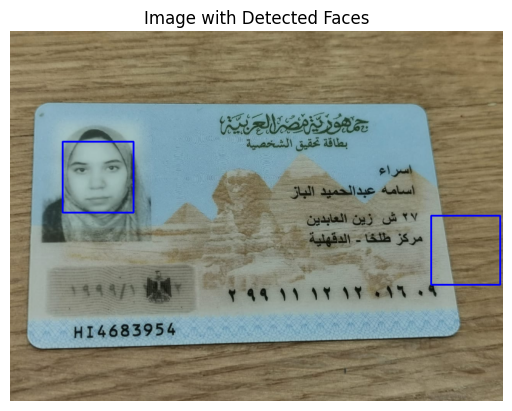

Processed image saved: /content/data_with_faces/20.jpg


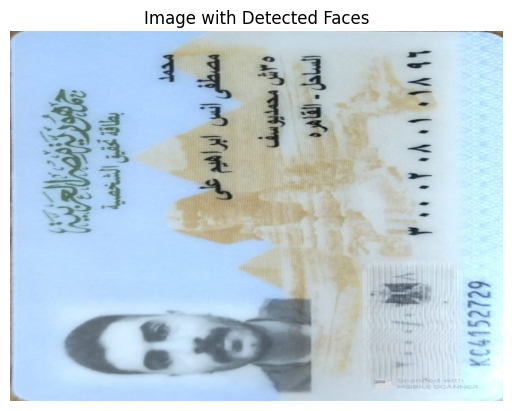

Processed image saved: /content/data_with_faces/21.jpg


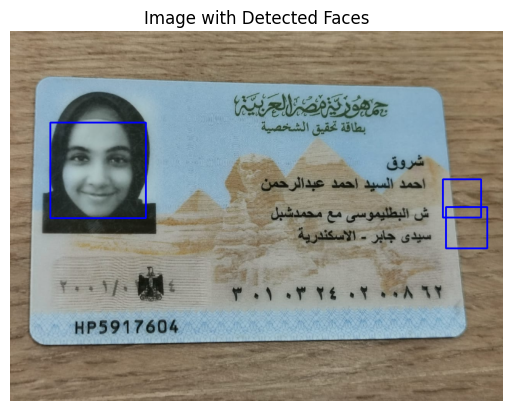

Processed image saved: /content/data_with_faces/1.jpg


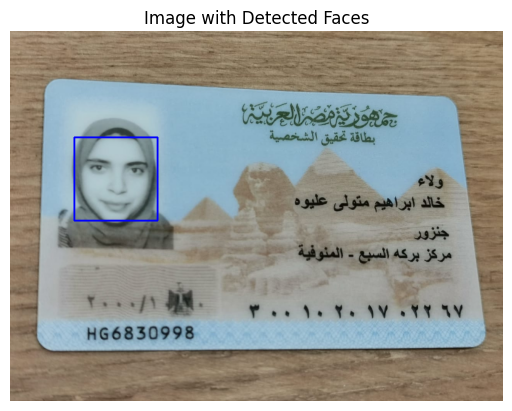

Processed image saved: /content/data_with_faces/13.jpg


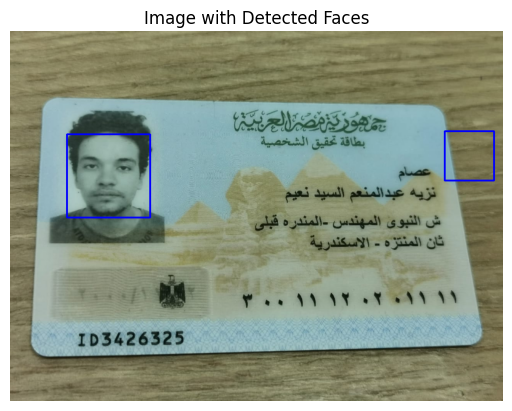

Processed image saved: /content/data_with_faces/2.jpg


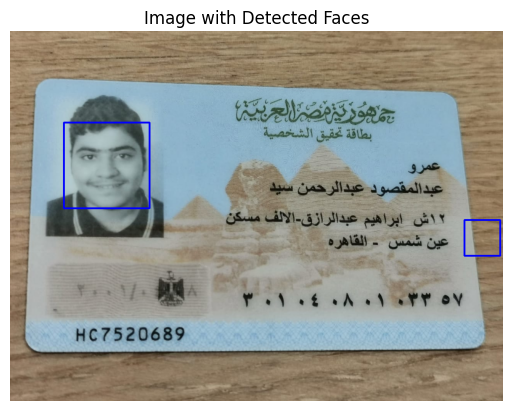

Processed image saved: /content/data_with_faces/10.jpg


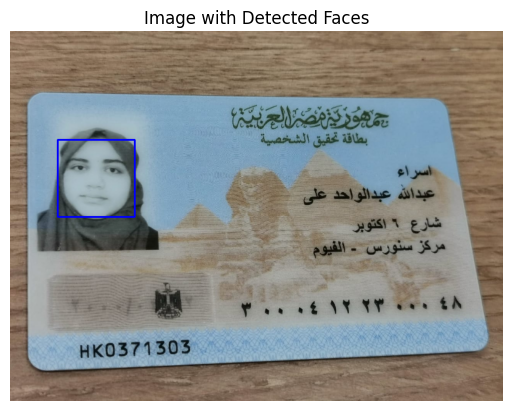

Processed image saved: /content/data_with_faces/26.jpg


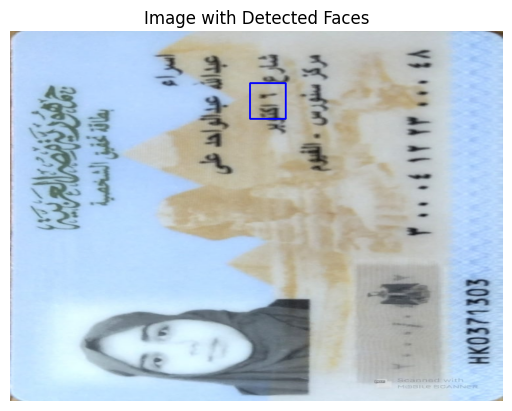

Processed image saved: /content/data_with_faces/16.jpg


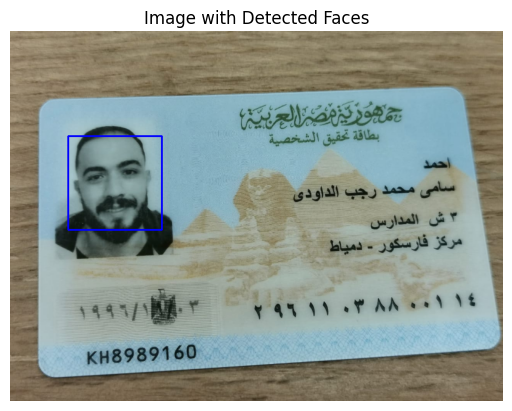

Processed image saved: /content/data_with_faces/5.jpg


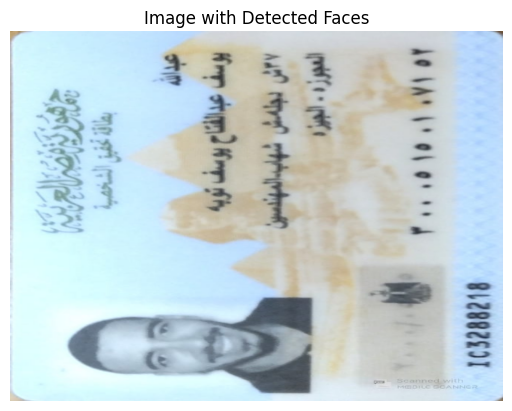

Processed image saved: /content/data_with_faces/3.jpg


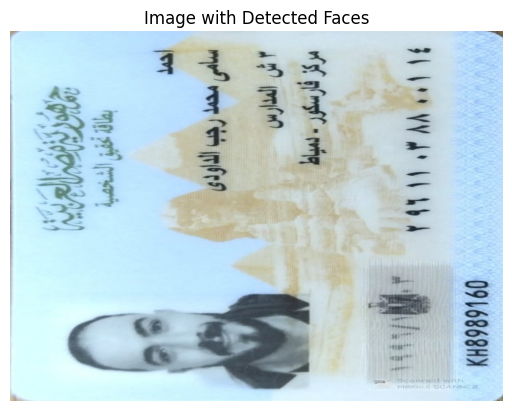

Processed image saved: /content/data_with_faces/17.jpg


In [16]:
import cv2
import os
import matplotlib.pyplot as plt

# Load the pre-trained face detection model
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

# Define input and output directories
input_dir = "/content/input_images"
output_dir = "/content/data_with_faces"

# Create the output directory if it does not exist
os.makedirs(output_dir, exist_ok=True)

# Loop through images in the input directory
for filename in os.listdir(input_dir):
    if filename.endswith(".jpg") or filename.endswith(".png"):
        # Read image
        img_path = os.path.join(input_dir, filename)
        img = cv2.imread(img_path)

        # Resize image for faster processing
        img = cv2.resize(img, (800, 600))  # You can adjust the dimensions as needed

        # Convert image to grayscale
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

        # Detect faces in the image
        faces = face_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=5, minSize=(30, 30))

        # Draw bounding boxes around the detected faces
        for (x, y, w, h) in faces:
            cv2.rectangle(img, (x, y), (x+w, y+h), (255, 0, 0), 2)

        # Display image with detected faces
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.imshow(img_rgb)
        plt.axis('off')
        plt.title("Image with Detected Faces")
        plt.show()

        # Save image with detected faces
        output_path = os.path.join(output_dir, filename)
        cv2.imwrite(output_path, img)

        print(f"Processed image saved: {output_path}")


In [13]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt

# Load the pre-trained face detection model
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

# Define input and output directories
input_dir = "/content/input_images"
output_dir = "/content/data_with_faces"

# Create the output directory if it does not exist
os.makedirs(output_dir, exist_ok=True)

# Function to align faces
def align_face(img, face):
    (x, y, w, h) = face
    center = (x + w // 2, y + h // 2)
    angle = 0.0  # Initialize angle

    try:
        # Perform face alignment based on eye detection
        eyes = face_cascade.detectMultiScale(img[y:y + h, x:x + w], scaleFactor=1.1, minNeighbors=5, minSize=(30, 30))
        if len(eyes) >= 2:
            # Calculate the angle between the eyes
            eyes_center = np.mean(eyes[:, :2], axis=0)
            dY = eyes[1][1] - eyes[0][1]
            dX = eyes[1][0] - eyes[0][0]
            angle = np.degrees(np.arctan2(dY, dX))

    except Exception as e:
        print(f"Error in face alignment: {e}")

    # Rotate the image around the center by the calculated angle
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    aligned_face = cv2.warpAffine(img, M, (img.shape[1], img.shape[0]), flags=cv2.INTER_CUBIC)

    return aligned_face

# Loop through images in the input directory
for filename in os.listdir(input_dir):
    if filename.endswith(".jpg") or filename.endswith(".png"):
        # Read image
        img_path = os.path.join(input_dir, filename)
        img = cv2.imread(img_path)

        # Resize image for faster processing
        img = cv2.resize(img, (800, 600))  # You can adjust the dimensions as needed

        # Convert image to grayscale
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

        # Detect faces in the image
        faces = face_cascade.detectMultiScale(gray, scaleFactor=1.3, minNeighbors=5, minSize=(30, 30))

        # Draw bounding boxes around the detected faces
        for (x, y, w, h) in faces:
            cv2.rectangle(img, (x, y), (x+w, y+h), (255, 0, 0), 2)

            # Align and rotate the detected face
            aligned_face = align_face(img, (x, y, w, h))

            # Display the aligned face
            aligned_face_rgb = cv2.cvtColor(aligned_face, cv2.COLOR_BGR2RGB)
            plt.imshow(aligned_face_rgb)
            plt.axis('off')
            plt.title("Aligned Face")
            plt.show()

        # Save image with bounding boxes and aligned faces
        output_path = os.path.join(output_dir, filename)
        cv2.imwrite(output_path, img)

        print(f"Processed image saved: {output_path}")


Processed image saved: /content/data_with_faces/4.jpg
Processed image saved: /content/data_with_faces/6.jpg


TypeError: Can't parse 'center'. Sequence item with index 0 has a wrong type